<a href="https://colab.research.google.com/github/elsioantunes/proc-video/blob/main/procVideoLab6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Corners detection  e  Scale-Invariant Feature Transform (SIFT)


## Objetivos:

1. Aplicar uma quantidade de conceitos de processamento de vídeo da disciplina.
 $\color{#DDDD00}{\text{em processo}}$
2.  Estudar detecção de cantos e bordas e os algoritmos de Harris e Shi-Tomasi. $\color{#00DD00}{\text{OK}}$
3.  Estudar e aplicar os mecanismos de SIFT (Scale-Invariant Feature Transform) $\color{#00dd00}{\text{OK}}$



In [ ]:
import pandas as pd
import numpy as np
import random as rnd
import cv2 as cv
import seaborn as sns

sns.set_theme()

from base64 import b64encode, b64decode
from google.colab.patches import cv2_imshow
from google.colab.output import eval_js
from IPython.display import HTML, Image, display, Javascript
 
def show(img):
    return cv2_imshow(img)

def show2(img1, img2):
    show(np.hstack([dim3(img1), dim3(img2)]))
 
def putext(img, txt, cor=(255, 255, 255), lin=0):
    cv.putText(img,  str(txt), (7, 26 + lin*25), cv.FONT_HERSHEY_SIMPLEX, 0.7, (32, 32, 32), 2, cv.LINE_AA)
    cv.putText(img,  str(txt), (5, 25 + lin*25), cv.FONT_HERSHEY_SIMPLEX, 0.7, cor, 1, cv.LINE_AA)

def rndColor():
    r = rnd.randrange(50, 240)
    g = rnd.randrange(50, 240)
    b = rnd.randrange(50, 240)
    return (r, g, b)
 
def dim3(img):
    if len(img.shape) == 2:
        img = cv.merge([img, img, img])
    return img.astype('uint8')
 
from ipywidgets import IntProgress

def openVideo(url):
    cap = cv.VideoCapture(url)
    ret, frame = cap.read()
    h, w = frame.shape[:2]
    fps = cap.get(cv.CAP_PROP_FPS)
    fc = cap.get(cv.CAP_PROP_FRAME_COUNT)
    print("frame count:", fc)
    print("width, height, fps:", w, h, fps)
    return fc, w, h, cap

def newVideo(frame, outUrl='video.mp4', codec='VP90'):
    fourcc = cv.VideoWriter_fourcc(*codec)
    h, w = frame.shape[:2]
    return cv.VideoWriter(outUrl, fourcc, 25, (w, h))

!curl -o cuboBar.jpg https://elsioantunes.github.io/proc-video/cuboBar.jpg
!curl -o cuboEmbar.jpg https://elsioantunes.github.io/proc-video/cuboEmbar.jpg
!curl -o cores321.png https://elsioantunes.github.io/proc-video/cores321.png
!curl -o a.jpg https://elsioantunes.github.io/proc-video/a.jpg
!curl -o a1.jpg https://elsioantunes.github.io/proc-video/a1.jpg

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 85940  100 85940    0     0   485k      0 --:--:-- --:--:-- --:--:--  485k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  107k  100  107k    0     0   914k      0 --:--:-- --:--:-- --:--:--  914k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  457k  100  457k    0     0  2207k      0 --:--:-- --:--:-- --:--:-- 2207k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  4500  100  4500    0     0  42857      0 --:--:-- --:--:-- --:--:-- 42857
  % Total    % Received % Xferd  Average Speed   Tim

Vamos utilizar duas imagens de cubos mágicos para testar os códigos de detecção de corners. Particularmente, me interessa definir estas figuras de forma vetorial para capturar suas cores (no futuro). 

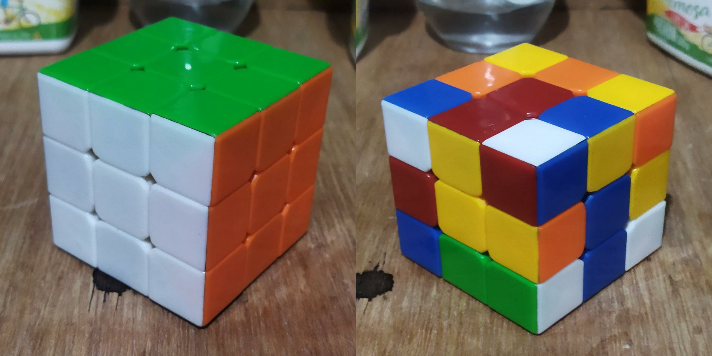

In [ ]:
cubo1 = cv.imread('cuboBar.jpg')
cubo2 = cv.imread('cuboEmbar.jpg')

h, w = cubo1.shape[:2]
cubo1m = cv.resize(cubo1, (w//3, h//3))

h, w = cubo1.shape[:2]
cubo2m = cv.resize(cubo2, (w//3, h//3))

show2(cubo1m, cubo2m)

A visão humana consegue determinar facilmente os cantos e até outras nuances desses objetos. Mas para que um algoritmo possa ver isso é necessário recorrer a teoria sobre como funciona a detecção de cantos, inicialmente estudada por **Chris Harris & Mike Stephens** em 1988. Segundo Harris, os cantos são regiões com irradiações de intensidades diferentes para todas as direções de cada pixel. Esta descrição é relativamente fácil de descrever matemáticamente:<br><br> 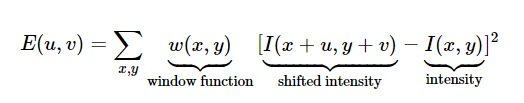

Como se pode ver de forma clara (para matemáticos) esta é uma função que retorna um valor numérico a partir da soma dos quadrados das diferenças de intensidade entre o pixel e sua vizinhança.
* Se este número for baixo significa que o pixel está em uniformidade com seus vizinhos, ou seja, independente da cor deste pixel, seus vizinhos tem cores muito próximas. Então, o que queremos é o contrário disto. 

Maximizar esta função é encontrar os pontos que podemos chamar de críticos. Se são ou não corners é uma questão semântica que teremos que resolver. 

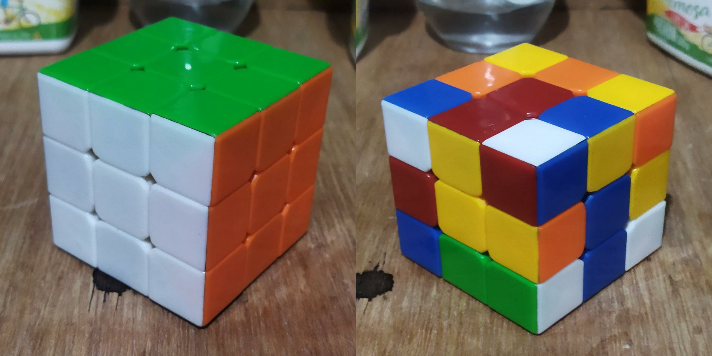

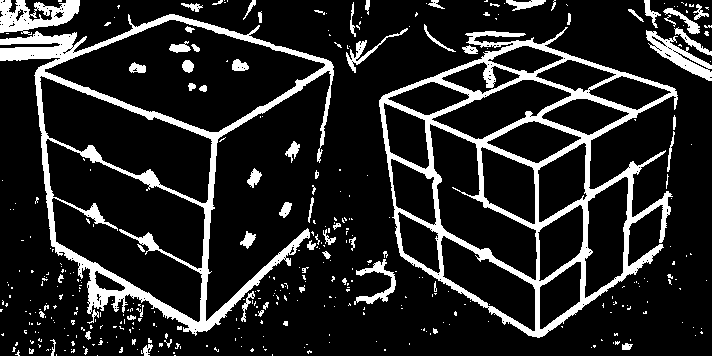

In [ ]:
def Corner2(img):
    r, g, b = cv.split(img)
    r32 = np.float32(r)
    g32 = np.float32(g)
    b32 = np.float32(b)

    dstr = cv.cornerHarris(r32, 3, 5, 0.03)
    dstg = cv.cornerHarris(g32, 3, 5, 0.03)
    dstb = cv.cornerHarris(b32, 3, 5, 0.03)

    ret = np.zeros_like(r) 
    ret[abs(dstb) > dstb.max()/3000] = 255
    ret[abs(dstr) > dstr.max()/3000] = 255
    ret[abs(dstg) > dstg.max()/3000] = 255

    return ret

show2(cubo1m, cubo2m)
show2(Corner2(cubo1m), Corner2(cubo2m))

Parece um resultado melhor que o obtido com o filtro Canny. Foram tentadas várias formas de se obter um esqueleto para representar o cubo no Projeto da disciplina... sem sucesso até agora. A intenção era identificar a posição do cubo e extrair uma versão 3d de onde, possivelmente, seria mais fácil para extrair as cores das posições certas. 

## Corners HSV

Eu pretendo aplicar o cálculo de Harris, na sua forma Shi-Tomasi pois esta versão tem melhorias significativas. Por ex, ela retorna já a lista de pontos no plano cartesiano e não uma imagem como Harris. Primeiramente a ideia é pesquisar o que acontece quando aplicamos o algoritmo aos canais HSV em separado

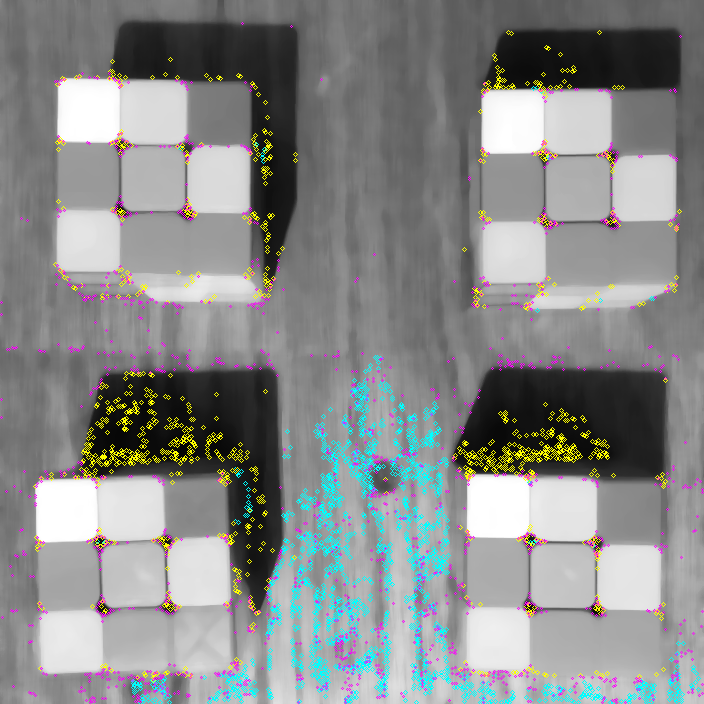

In [ ]:
img = cv.imread('cores321.png')
#img = cv.imread('cuboEmbar.jpg')
h, w = img.shape[:2]

img = cv.medianBlur(img, 11)
h, s, v = cv.split(cv.cvtColor(img, cv.COLOR_RGB2HSV))
img2 = dim3(v)

corners = cv.goodFeaturesToTrack(h, 1610, 0.01, 1, blockSize=2)
for i in corners:
    x, y = i.ravel()
    cv.circle(img2, (x, y), 2, (255, 255, 0), 1)

corners = cv.goodFeaturesToTrack(s, 1610, 0.01, 1, blockSize=2)
for i in corners:
    x, y = i.ravel()
    cv.circle(img2, (x, y), 2, (0, 255, 255), 1)

corners = cv.goodFeaturesToTrack(v, 1610, 0.01, 1, blockSize=2)
for i in corners:
    x, y = i.ravel()
    cv.circle(img2, (x, y), 1, (255, 0, 255), 1)

show (img2)

Em seguida, façamos o mesmo com os canais RGB

## Corners RGB

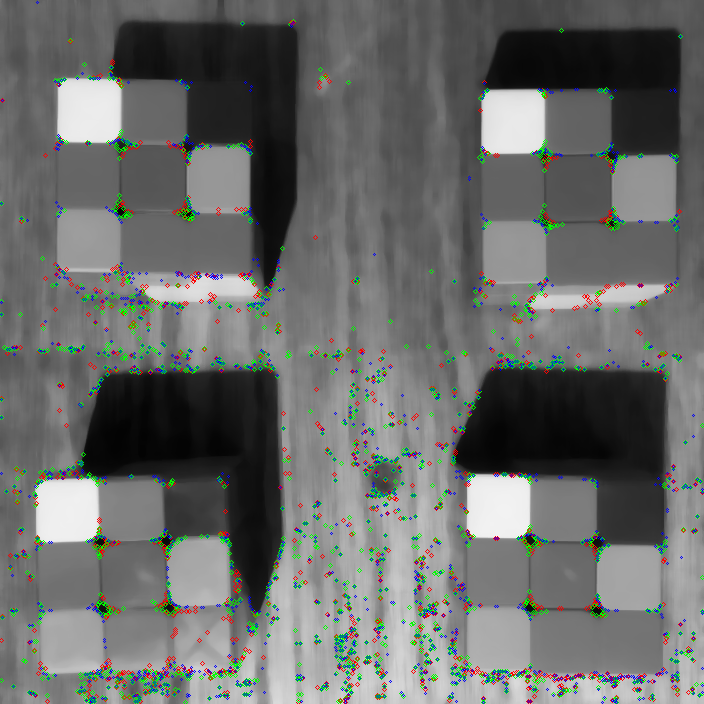

In [ ]:
img = cv.imread('cores321.png')
#img = cv.imread('cuboEmbar.jpg')
h, w = img.shape[:2]

img = cv.medianBlur(img, 11)
r, g, b = cv.split(img)
img2 = dim3(cv.cvtColor(img, cv.COLOR_RGB2GRAY))

corners = cv.goodFeaturesToTrack(r, 1610, 0.01, 1, blockSize=2)
for i in corners:
    x, y = i.ravel()
    cv.circle(img2, (x, y), 2, (0, 0, 255), 1)

corners = cv.goodFeaturesToTrack(g, 1610, 0.01, 1, blockSize=2)
for i in corners:
    x, y = i.ravel()
    cv.circle(img2, (x, y), 2, (0, 255, 0), 1)

corners = cv.goodFeaturesToTrack(b, 1610, 0.01, 1, blockSize=2)
for i in corners:
    x, y = i.ravel()
    cv.circle(img2, (x, y), 1, (255, 0, 0), 1)

show (img2)

Me ocorreu agora que eu poderia ter feito os dois na mesma função.

## func1

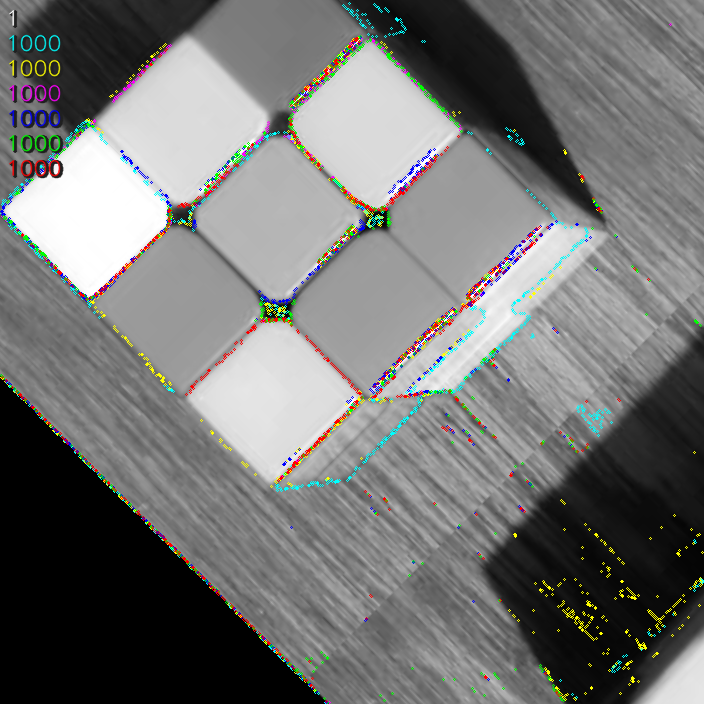

In [ ]:
def rotate(img):
    h, w = img.shape[:2]
    matrix = cv.getRotationMatrix2D((155, 180/2), 45, 2)
    return  cv.warpAffine(img, matrix, (w, h))

def cornersHSVRGB1(img, k = 1, m = 5, video=False):
    if not video:
        img = rotate(img)
    h, w = img.shape[:2]
    
    if video:
        img = cv.medianBlur(img, 2*m+1)

    h, s, v = cv.split(cv.cvtColor(img, cv.COLOR_RGB2HSV))
    r, g, b = cv.split(img)

    img2 = dim3(v)

    tasks = [
        [h, (255, 255, 0)],
        [s, (0, 255, 255)],
        [v, (255, 0, 255)],
        [r, (255, 0, 0)],
        [g, (0, 255, 0)],
        [b, (0, 0, 255)],
    ]
    res = []

    for layer, cor in tasks:
        corners = cv.goodFeaturesToTrack(layer, 1000, 0.001, 0, blockSize=k)
        hlen = corners.shape[0]
        res.append([hlen, cor])
        for i in corners:
            x, y = i.ravel()
            cv.circle(img2, (x, y), 1, cor, 1)

    putext(img2, k)
    for i, (len, cor) in enumerate(res):
        putext(img2, len, cor, i+1)

    return img2

img2 = cornersHSVRGB1(cv.imread('cores321.png'), 1)

show (img2)

## func2

In [ ]:
def goodFeatures(img):
    corners = cv.goodFeaturesToTrack(img, maxCorners=2000, qualityLevel=0.01, minDistance=1, blockSize=1)
    corners = corners.reshape(corners.shape[0], 2)
    ncorners = corners.shape[0]
    return ncorners, corners 

def cornersHSVRGB(img, k = 1, m = 1):
    h, w = img.shape[:2]
    img = img[:h//2, :w//2]
    img = cv.resize(img, (w, h))

    h, s, v = cv.split(cv.cvtColor(img, cv.COLOR_RGB2HSV))
    r, g, b = cv.split(img)

    img2 = dim3(v/4)

    #legnenda = []
    df = pd.DataFrame()
    for i, channel in enumerate([h, s, v, b, g, r]):
        count, corners = goodFeatures(channel)
        #legnenda.append([count, cor])
        
        dp = pd.DataFrame(corners)
        dp['class'] = [i]*count
        df = pd.concat([df, dp])

        '''
        putext(img2, k)
        for i, (len, cor) in enumerate(legnenda):
            putext(img2, len, cor, i+1)
        '''
    
    return df

df = cornersHSVRGB(cv.imread('cores321.png'), 1)

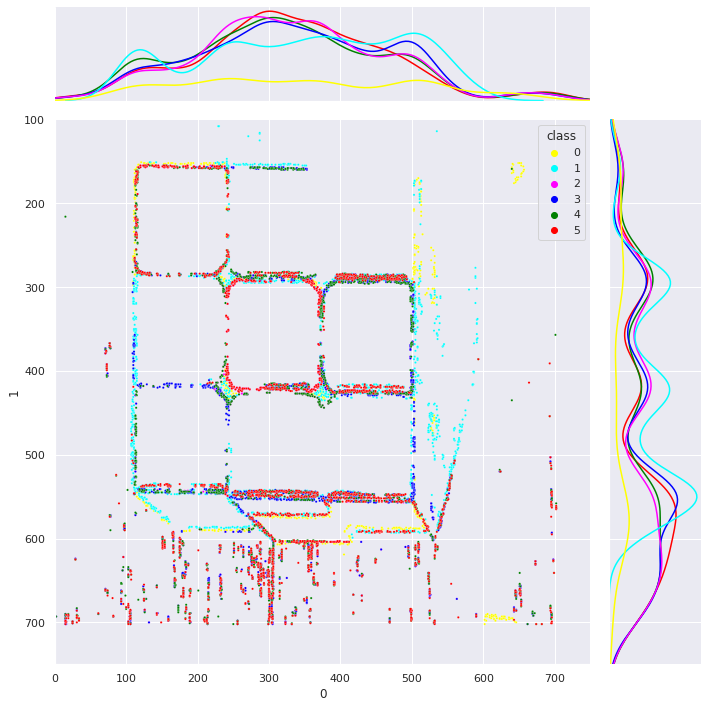

In [ ]:
pal = ['yellow', 'cyan', 'magenta', 'blue', 'green', 'red']
g = sns.JointGrid(data=df, x=df[0], y=df[1], hue=df['class'], palette=pal, height=10, xlim=(0,750), ylim=(750,100))
g.plot_joint(sns.scatterplot, s=5)
g.plot_marginals(sns.kdeplot)

A intenção da plotagem usando seaborn é procurar alguma relação entre os corners de cada canal que possa me ajudar a obter as posições exatas de onde eu possa extrair as cores. Minha intenção era completar as lacunas com contornos obtidos classificação dos espaços. Mas como se pode observar os dados não estão distribuidos de uma forma que eu pudesse deduzir os contornos de forma fácil. 

Continuando a saga de tentar obter dos corners uma forma de modelar virtualmente o cubo. Ainda sem sucesso.

## Corners video

Aqui uma série de tentativas de obter significado nos pontos detectados pelos algoritmos de corners. Neste momento, pontos detectados são apenas pontos. Faz-se necessário a interpretação dos mesmos. E isto é feito nas próximas seções quando falaremos de SIFT

In [ ]:
!curl -o v.mp4 https://elsioantunes.github.io/proc-video/cuboPend2.mp4
#!ffmpeg -i v.mp4 -filter_complex "reverse" -y -an video.mp4
!cp v.mp4 /usr/local/share/jupyter/nbextensions/v.mp4

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 3337k  100 3337k    0     0  13.1M      0 --:--:-- --:--:-- --:--:-- 13.1M


trecho para download e visualização do (video a ser processado)

infelizmente não se pode visualizar pelo git. Salve uma cópia deste notebook para ver os resultados

In [ ]:
%%html
<video controls>
    <source src='nbextensions/v.mp4'>
</video>

In [ ]:
inUrl = '/usr/local/share/jupyter/nbextensions/v.mp4'
outUrl = '/usr/local/share/jupyter/nbextensions/out.mp4'

out = None
ret = True
totalFrames, w, h, cap = openVideo(inUrl)
totalFrames = 50 # int(totalFrames)

progressBar = IntProgress(min=0, max=totalFrames) 
display(progressBar) 

for i in range(totalFrames):
    data = []
    ret, frame = cap.read()
    if ret:
        gray = cv.cvtColor(frame, cv.COLOR_RGB2GRAY)
        gray = np.float32(gray)
        dst = cv.cornerHarris(gray, 2, 3, 0.04)
        #dst = cv.dilate(dst, None)

        frame[dst*dst > 0.001*dst.max()] = (255, 0, 0)

        frame[dst>0.01*dst.max()]      = (0, 0, 255)

        if out == None: out = newVideo(frame, outUrl)
        
        out.write(frame)
        progressBar.value += 1

cap.release()
out.release()

frame count: 426.0
width, height, fps: 640 352 30.0


IntProgress(value=0, max=50)

In [ ]:
%%html
<video controls>
    <source src='nbextensions/out.mp4'>
</video>

## Corners2 video

In [ ]:
def MaskClose(img, k=10, iterations=1):
    kernel = cv.getStructuringElement(cv.MORPH_ELLIPSE,(k, k))    
    img = cv.morphologyEx(img, cv.MORPH_CLOSE, kernel, iterations=iterations)
    return img

def MaskOpen(img, k=10, iterations=1):
    kernel = cv.getStructuringElement(cv.MORPH_ELLIPSE,(k, k))    
    img = cv.morphologyEx(img, cv.MORPH_OPEN, kernel, iterations=iterations)
    return img

inUrl = '/usr/local/share/jupyter/nbextensions/v.mp4'
outUrl = '/usr/local/share/jupyter/nbextensions/out.mp4'

out = None
ret = True
totalFrames, w, h, cap = openVideo(inUrl)
totalFrames =  15 # int(totalFrames)

progressBar = IntProgress(min=0, max=totalFrames) 
display(progressBar) 


for i in range(totalFrames):
    data = []
    ret, frame = cap.read()
    if ret:
        gray = cv.cvtColor(frame, cv.COLOR_RGB2GRAY)

        corners = cv.goodFeaturesToTrack(gray, 60, 0.001, 20)
        corners = np.int0(corners)
        for i in corners:
            x, y = i.ravel()
            cv.circle(frame, (x, y), 8, (0, 255, 0), 1)

        corners = cv.goodFeaturesToTrack(gray, 30, 0.1, 20)
        corners = np.int0(corners)
        for i in corners:
            x, y = i.ravel()
            cv.circle(frame, (x, y), 4, (0, 0, 255), -1)

        if out == None: out = newVideo(frame, outUrl)
        
        out.write(frame)
        progressBar.value += 1

cap.release()
out.release()

frame count: 418.0
width, height, fps: 640 352 29.73480537218302


IntProgress(value=0, max=15)

Olha que interessante: os códigos agora vão ter uma progressbar :)

In [ ]:
%%html
<video controls>
    <source src='nbextensions/out.mp4'>
</video>

se precisar baixar este video, prefira a versão em m4v que poderá ser convertido com o ffmpeg abaixo e baixado pela pastinha ao lado

In [ ]:
!ffmpeg -i {outUrl} -y video.m4v

## Corners3 video


In [ ]:
out = None
ret = True
img = cornersHSVRGB1(cv.imread('cores321.png'), video=True)
h, w = img.shape[:2]
totalFrames = 50 

progressBar = IntProgress(min=0, max=totalFrames) 
display(progressBar) 

for i in range(totalFrames):
    
    m = (np.cos(i*2*np.pi/totalFrames) + 1) * 25 
    m= int(m)
    
    frame = cornersHSVRGB1(img[h//2:h, 0:w//2], k=2, m=m, video=True)

    if out == None: out = newVideo(frame, outUrl)
    
    out.write(frame)
    progressBar.value += 1

out.release()

IntProgress(value=0, max=50)

In [ ]:
%%html
<video controls>
    <source src='nbextensions/out.mp4'>
</video>

## Corners3b video

In [ ]:
inUrl = '/usr/local/share/jupyter/nbextensions/v.mp4'
outUrl = '/usr/local/share/jupyter/nbextensions/out.mp4'

out = None
ret = True
totalFrames, w, h, cap = openVideo(inUrl)
totalFrames = 150 #int(totalFrames)

progressBar = IntProgress(min=0, max=totalFrames*10) 
display(progressBar) 

ret, frame = cap.read()
out = newVideo(frame, outUrl)

for j in [1, 2, 10]:
    _, w, h, cap = openVideo(inUrl)
    for i in range(totalFrames):
        data = []
        ret, frame = cap.read()
        if ret:
            frame2 = cornersHSVRGB1(frame, j, video=True)
            out.write(frame2)
            
            progressBar.value += 1
    cap.release()

out.release()

frame count: 418.0
width, height, fps: 640 352 29.73480537218302


IntProgress(value=0, max=1500)

frame count: 418.0
width, height, fps: 640 352 29.73480537218302
frame count: 418.0
width, height, fps: 640 352 29.73480537218302
frame count: 418.0
width, height, fps: 640 352 29.73480537218302


In [ ]:
%%html
<video controls>
    <source src='nbextensions/out.mp4'>
</video>

In [ ]:
!ffmpeg -i {outUrl} -y video.m4v

## Sift
 

In [ ]:
!pip install opencv-python==3.4.2.16 opencv-contrib-python==3.4.2.16

ERROR: Could not find a version that satisfies the requirement opencv-python==3.4.2.16 (from versions: 3.4.2.17, 3.4.3.18, 3.4.4.19, 3.4.5.20, 3.4.6.27, 3.4.7.28, 3.4.8.29, 3.4.9.31, 3.4.9.33, 3.4.10.35, 3.4.10.37, 3.4.11.39, 3.4.11.41, 3.4.11.43, 3.4.11.45, 3.4.13.47, 3.4.14.51, 3.4.14.53, 3.4.15.55, 4.0.0.21, 4.0.1.23, 4.0.1.24, 4.1.0.25, 4.1.1.26, 4.1.2.30, 4.2.0.32, 4.2.0.34, 4.3.0.36, 4.3.0.38, 4.4.0.40, 4.4.0.42, 4.4.0.44, 4.4.0.46, 4.5.1.48, 4.5.2.52, 4.5.2.54, 4.5.3.56)
ERROR: No matching distribution found for opencv-python==3.4.2.16


In [ ]:
img = cv.imread('cores321.png', cv.IMREAD_GRAYSCALE)
h, w = img.shape[:2]

img1 = img[:h//2, :w//2]
img2 = img[h//2:h, :w//2]

sift = cv.SIFT_create()

kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)

bf = cv.BFMatcher()
matches = bf.knnMatch(des1, des2, k=2)

good = []
for m,n in matches:
    if m.distance < 0.75*n.distance:
        good.append([m])

# cv.drawMatchesKnn expects list of lists as matches.
img3 = cv.drawMatchesKnn(img1,kp1,img2,kp2,good,None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

show (img3)

A tentativa de executar o código original do SIFT falhou e não encontrei nenhum jeito fácil de instalar para rodar a função. Disseram que tem um problema de patente que faz com que nem todas as versões do openCV possam utilizá-lo. Comecei então a procurar uma forma de implementar o código por fora do openCV

## Scale-Invariante Feature Transform

É fácil perceber que os corners que encontramos com `cv.cornerHarris()` e Shi-Tomasi Corner Detector `cv.goodFeaturesToTrack()` são invariantes com relação a rotação pois se baseiam numa minimização de uma equação que analisa uma janela com raio de k vizinhos. No entanto, um corner pode deixar de ser um corner dependendo da escala em que se analisa. 

A seguinte aplicação tem como objetivo o reconhecimento de formas (shapes) em diferentes escalas e transformações afins na imagem, de podo que seja possível reconhecer um caractere ou uma figura geométrica mesmo deformada, rotacionada ou invertida.

* Trata-se de uma comparação de dois conjuntos de pontos (de que se forma o shape) a partir de um algoritmo linear que minimiza uma matriz de distâncias.

* A invariância de escala e rotação se dá a partir da construção de um descritor que guarda nas propriedades dos pontos uma forma de identificação, baseada em coordenadas polares e um histograma, que conta quantos vizinhos existem em uma determinada direção. 

* Uma vez que cada vertice sabe o seu papel dentro de um shape (a posicção que ele ocupa em relação aos demais) fica mais fácil comparar dois conjuntos de pontos em busca de similaridade, não só espacial mas também estrutural


In [ ]:
!curl -o a.jpg https://elsioantunes.github.io/proc-video/a.jpg
!curl -o a1.jpg https://elsioantunes.github.io/proc-video/a1.jpg

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  4500  100  4500    0     0  40178      0 --:--:-- --:--:-- --:--:-- 40178
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  7580  100  7580    0     0  57862      0 --:--:-- --:--:-- --:--:-- 57862


In [ ]:
'''
    Shape Context descriptor and fast characters recognition

    código obtido em: 
    https://medium.com/machine-learning-world/shape-context-descriptor-and-fast-characters-recognition-c031eac726f9

'''

from scipy.spatial.distance import cdist, cosine
from scipy.optimize import linear_sum_assignment

class ShapeContext(object):

    def __init__(self, nbins_r=5, nbins_theta=12, r_inner=0.1250, r_outer=2.0):
        # number of radius zones
        self.nbins_r = nbins_r
        
        # number of angles zones
        self.nbins_theta = nbins_theta
        
        # maximum and minimum radius
        self.r_inner = r_inner
        self.r_outer = r_outer

    def _hungarian(self, matrix):
        """
            Here we are solving task of getting similar points from two paths
            based on their cost matrixes. 

            This algorithm has dificulty O(n^3)

            return total modification cost, indexes of matched points
        """
        rows, cols = linear_sum_assignment(matrix)
        indexes = zip(rows, cols)
        total = matrix[rows, cols].sum()
        return total, indexes

    def _cost(self, hi, hj):
        cost = 0
        for k in range(self.nbins_theta * self.nbins_r):
            if (hi[k] + hj[k]):
                cost += ((hi[k] - hj[k])**2) / (hi[k] + hj[k])
        return cost * 0.5

    def cost_by_paper(self, P, Q):
        p, _ = P.shape
        C = np.zeros((p, p))
        for i in range(p):
            for j in range(p):
                C[i, j] = self._cost(Q[j] / p, P[i] / p)
        return C

    def diff(self, P, Q):
        C = self.cost_by_paper(P, Q)
        result = self._hungarian(C)
        return result
        
    def compute(self, points):
        t_points = len(points)

        # getting euclidian distance
        r_array = cdist(points, points)

        # getting two points with maximum distance to norm angle by them
        # this is needed for rotation invariant feature
        am = r_array.argmax()
        max_points = [am / t_points, am % t_points]

        # normalizing
        r_array_n = r_array / r_array.mean()

        # create log space
        r_bin_edges = np.logspace(np.log10(self.r_inner), np.log10(self.r_outer), self.nbins_r)
        r_array_q = np.zeros((t_points, t_points), dtype=int)

        # summing occurences in different log space intervals
        # logspace = [0.1250, 0.2500, 0.5000, 1.0000, 2.0000]
        # 0    1.3 -> 1 0 -> 2 0 -> 3 0 -> 4 0 -> 5 1
        # 0.43  0     0 1    0 2    1 3    2 4    3 5
        for m in range(self.nbins_r):
            r_array_q += (r_array_n < r_bin_edges[m])

        fz = r_array_q > 0

        # getting angles in radians
        theta_array = cdist(points, points, lambda u, v: np.arctan2((v[1] - u[1]), (v[0] - u[0])))
        norm_angle = theta_array[int(max_points[0]), int(max_points[1])]
        
        # making angles matrix rotation invariant
        theta_array = (theta_array - norm_angle * (np.ones((t_points, t_points)) - np.identity(t_points)))

        # removing all very small values because of float operation
        theta_array[np.abs(theta_array) < 1e-7] = 0

        # 2Pi shifted because we need angels in [0,2Pi]
        theta_array_2 = theta_array + 2 * np.pi * (theta_array < 0)
        # Simple Quantization
        theta_array_q = (1 + np.floor(theta_array_2 / (2 * np.pi / self.nbins_theta))).astype(int)

        # building point descriptor based on angle and distance
        nbins = self.nbins_theta * self.nbins_r
        descriptor = np.zeros((t_points, nbins))

        for i in range(t_points):
            sn = np.zeros((self.nbins_r, self.nbins_theta))
            for j in range(t_points):
                if (fz[i, j]):
                    sn[r_array_q[i, j] - 1, theta_array_q[i, j] - 1] += 1
            descriptor[i] = sn.reshape(nbins)

        return descriptor


A partir do momento em que temos uma forma de mapear a posição de cada ponto em relação aos outros pontos, ou seja, temos um descritor para a figura, fica mais fácil comparar e assim utilizar em uma série de aplicações práticas como por ex deteção e reconhecimento de objetos em imagens.

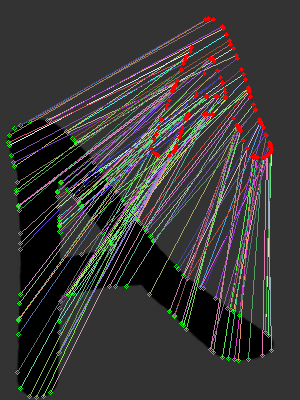

Standard diff: 28.788413000237625


In [ ]:
def getPoints(img, npoints=100):
    img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    dst = cv.Canny(img, 50, 150)
    points = cv.findNonZero(dst)
    points = points[:, 0, :]
    idxs = np.random.choice(len(points), npoints)
    return points[idxs]


def plot(img, img2, n=5):
    sc = ShapeContext()

    npoints = 130

    # tentando encontrar o conjunto de ligações com menor distancia
    standard_cost = 1000
    for i in range(n):
        p1 = getPoints(img, npoints)
        p2 = getPoints(img2, npoints)

        fP = sc.compute(p1)
        fQ = sc.compute(p2)
        cost, ind = sc.diff(fP, fQ)

        if  standard_cost > cost:
            standard_cost = cost
            Q = fQ
            P = fP
            indexes = ind
            points1 = p1
            points2 = p2
    
    # tentando encontrar o conjunto de ligações com menor distancia
    standard_cost = 1000
    for i in range(n):
        p1 = getPoints(img, npoints)
        p2 = getPoints(img2, npoints)

        fP = sc.compute(p1)
        fQ = sc.compute(p2)
        cost, ind = sc.diff(fP, fQ)

        if  standard_cost > cost:
            standard_cost = cost
            Q = fQ
            P = fP
            indexes = ind
            points1 = p1
            points2 = p2

   
    # plotando e riscando a imagem
    img2 = dim3(img2) / 5
    for x, y in points2:
        cv.circle(img2, (x, y), 2, (0, 255, 0))
    for p, q in indexes:
        x1, y1 = points1[p]
        x2, y2 = points2[q]
        cv.line(img2, (x1, y1), (x2, y2), rndColor(), 1)
    for x, y in points1:
        cv.circle(img2, (x, y), 2, (0, 0, 255), -1)
    show(img2)

    print ("Standard diff:", standard_cost)

img = cv.imread('a.jpg')
img2 = cv.imread('a1.jpg')

plot(img, img2)

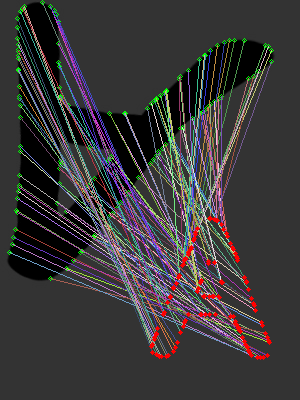

Standard diff: 33.95152144666285


In [ ]:
img = cv.imread('a.jpg')
img2 = cv.imread('a1.jpg')

h, w = img.shape[:2]
img = np.vstack([img[h//2:h, :], img[:h//2, :]])
img2 = img2[::-1]

plot(img, img2, 20)

# REFERÊNCIAS



* Shape Context descriptor and fast characters recognition <br> 
https://medium.com/machine-learning-world/shape-context-descriptor-and-fast-characters-recognition-c031eac726f9 


* Documentação OpenCV <br> 
https://docs.opencv.org/4.5.3/db/d27/tutorial_py_table_of_contents_feature2d.html <br> 
https://docs.opencv.org/4.5.3/df/d54/tutorial_py_features_meaning.html<br>
https://docs.opencv.org/4.5.3/dc/d0d/tutorial_py_features_harris.html<br>
https://docs.opencv.org/4.5.3/d4/d8c/tutorial_py_shi_tomasi.html<br>
https://docs.opencv.org/4.5.3/da/df5/tutorial_py_sift_intro.html<br>


* Classificadores treinados para captura de objetos <br> 
https://github.com/opencv/opencv/tree/master/data

* Tutorial Cascade Classifier OpenCV <br> 
https://docs.opencv.org/4.5.3/db/d28/tutorial_cascade_classifier.html

* Object Detection using Haar feature-based cascade classifiers <br> 
<a href='https://colab.research.google.com/github/computationalcore/introduction-to-opencv/blob/master/notebooks/4-Cascade_classification.ipynb#scrollTo=T2JCR1Z47g9L'>https://colab.research.google.com/github/computationalcore/</a>

* Motion Detection OpenCV Python <br> 
https://divyanshushekhar.com/motion-detection-opencv/

* Motion Analysis <br> 
https://docs.opencv.org/4.5.2/de/de1/group__video__motion.html





